# Your first end to end Machine Learning pipeline

Un pipeline básico de todo proyecto de machine learning consistiría a grandes rasgos en los siguientes pasos:

1. Recolección de datos: Obtener y almacenar datos de diferentes fuentes.
2. Preprocesamiento de datos: Limpiar y preparar los datos para el análisis. Esto puede incluir la eliminación 3. de valores atípicos, la normalización y la codificación de variables categóricas.
3. Análisis exploratorio de datos (EDA): Explorar los datos para encontrar patrones, tendencias y relaciones.
4. Preparación de los datos.
5. División de datos: Separar los datos en conjuntos de entrenamiento y prueba.
6. Selección de modelo: Elegir el algoritmo de machine learning adecuado para el problema.
7. Entrenamiento del modelo: Ajustar el modelo a los datos de entrenamiento.
8. Evaluación del modelo: Medir el rendimiento del modelo utilizando el conjunto de prueba.
9. Ajuste de hiperparámetros: Optimizar los hiperparámetros para mejorar el modelo.
10. Despliegue del modelo: Implementar el modelo en producción para hacer predicciones con nuevos datos.

En este caso tienes completados los pasos del 1 al 3, dado que hiciste un EDA en el ejercicio 5 del TP1; así que continuemos.

## 4. Preparación de los datos

4.1 Carga de vuelta en un pandas Dataframe los datos del archivo `dataset/train.csv`.

In [30]:
import pandas as pd
train_data = pd.read_csv('dataset/train.csv')

4.2 Realiza la limpieza de datos que implementaste en el inciso 4 del ejercicio de EDA.

Se te recomienda eliminar aquellas columnas con un alto porcentaje de valores faltantes, tales como:
`['PoolQC', 'MiscFeature', 'Alley', 'Fence']`.

Realiza las imputaciones que sean necesarias.

In [31]:
data_cleaned = train_data

# Calcular el porcentaje de valores nulos para cada columna
null_fraction = (data_cleaned.isnull().sum() / len(data_cleaned))

null_columns = null_fraction[null_fraction > 0.25 ].index

# Eliminar las columnas del DataFrame
data_cleaned = data_cleaned.drop(null_columns, axis=1)

print("Se eliminaron las siguientes columnas que tienen más del 25% de valores nulos:\n", null_columns)

# Reemplazo los valores nulos de las columnas con variables numéricas por la media del resto de la columna
for column in data_cleaned.select_dtypes(include=['int64', 'float64']).columns:
    data_cleaned[column] = data_cleaned[column].fillna(data_cleaned[column].mean())

# Reemplazo los valores nulos de las columnas con variables categoricas por la más probable del resto de la columna
for column in data_cleaned.select_dtypes(include=['object']).columns:
    data_cleaned[column] = data_cleaned[column].fillna(data_cleaned[column].mode()[0])

Se eliminaron las siguientes columnas que tienen más del 25% de valores nulos:
 Index(['Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature'], dtype='object')


Verifica los valores faltantes después de las imputaciones y la limpieza.
Puedes usar el siguiente código (comentado) a modo de ejemplo:

In [32]:
final_missing_values = data_cleaned.isnull().sum()
final_missing_values = final_missing_values[final_missing_values > 0].sort_values(ascending=False)
if final_missing_values.empty:
    print("No hay valores nulos en Train Dataset.")

No hay valores nulos en Train Dataset.


En ese caso, sustituye `data_cleaned` por tu DataFrame

Utiliza la función `info()`pandas para identificar los tipos de datos contenidos en las columnas del data frame.
ej: `data_cleaned.info()`.

En caso de que algunas de tus columnas tengan datos tipo `object`: Tienes que convertir ese tipo de dato en `categorical`, ya que algunos modelos de machine learning podrían explotar (nah mentira, pero te va a tirar error) si no haces esto.

In [33]:
data_cleaned.info()
object_cols = data_cleaned.select_dtypes(include='object').columns
data_cleaned[object_cols] = data_cleaned[object_cols].astype('category')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 76 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1460 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   LotShape       1460 non-null   object 
 7   LandContour    1460 non-null   object 
 8   Utilities      1460 non-null   object 
 9   LotConfig      1460 non-null   object 
 10  LandSlope      1460 non-null   object 
 11  Neighborhood   1460 non-null   object 
 12  Condition1     1460 non-null   object 
 13  Condition2     1460 non-null   object 
 14  BldgType       1460 non-null   object 
 15  HouseStyle     1460 non-null   object 
 16  OverallQual    1460 non-null   int64  
 17  OverallCond    1460 non-null   int64  
 18  YearBuil

In [34]:
import numpy as np
data_cleaned['SalePrice'] = np.log1p(data_cleaned['SalePrice'])

## 5. Separación de los datos: 

5.1 Carga los datos del archivo `dataset/test.csv`

In [35]:
test_data = pd.read_csv('dataset/test.csv')

5.2 Aplica la misma limpieza de datos que hiciste sobre los datos de train. Haz las mismas imputaciones, elimina las mismas columnas.

In [36]:
# Calcular el porcentaje de valores nulos para cada columna
null_fraction = (test_data.isnull().sum() / len(test_data))

null_columns = null_fraction[null_fraction > 0.25 ].index

# Eliminar las columnas del DataFrame
test_data = test_data.drop(null_columns, axis=1)

print("Se eliminaron las siguientes columnas que tienen más del 25% de valores nulos:\n", null_columns)

# Reemplazar los valores nulos de las columnas con variables numéricas por la media del resto de la columna
for column in test_data.select_dtypes(include=['int64', 'float64']).columns:
    test_data[column] = test_data[column].fillna(test_data[column].mean())

# Reemplazar los valores nulos de las columnas con variables categoricas por la más probable del resto de la columna
for column in test_data.select_dtypes(include=['object']).columns:
    test_data[column] = test_data[column].fillna(test_data[column].mode()[0])

Se eliminaron las siguientes columnas que tienen más del 25% de valores nulos:
 Index(['Alley', 'FireplaceQu', 'PoolQC', 'Fence', 'MiscFeature'], dtype='object')


In [37]:
test_data.info()
object_cols = test_data.select_dtypes(include='object').columns
test_data[object_cols] = test_data[object_cols].astype('category')

# One Hot Encoding
data_cleaned = pd.get_dummies(data_cleaned)
test_data = pd.get_dummies(test_data)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1459 entries, 0 to 1458
Data columns (total 75 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1459 non-null   object 
 3   LotFrontage    1459 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   LotShape       1459 non-null   object 
 7   LandContour    1459 non-null   object 
 8   Utilities      1459 non-null   object 
 9   LotConfig      1459 non-null   object 
 10  LandSlope      1459 non-null   object 
 11  Neighborhood   1459 non-null   object 
 12  Condition1     1459 non-null   object 
 13  Condition2     1459 non-null   object 
 14  BldgType       1459 non-null   object 
 15  HouseStyle     1459 non-null   object 
 16  OverallQual    1459 non-null   int64  
 17  OverallCond    1459 non-null   int64  
 18  YearBuil

5.3 Verifica que no queden valores nulos NA, Nans

In [38]:
final_missing_values_test = test_data.isnull().sum()
final_missing_values_test = final_missing_values_test[final_missing_values_test > 0].sort_values(ascending=False)
if final_missing_values_test.empty:
    print("No hay valores nulos en el Test Dataframe.")

No hay valores nulos en el Test Dataframe.


5.4 Verifica que tengas las mismas columnas tanto en el dataframe de train como de test.

In [39]:
different_columns_train = list(set(data_cleaned.columns).difference(set(test_data.columns)))

different_columns_train.remove('SalePrice')

different_columns_test = list(set(test_data.columns).difference(set(data_cleaned.columns)))

if not different_columns_train:
    print("\nNo hay columnas que esten presentes en el Dataframe de entrenamiento pero no en el de prueba.")
else:
    print("\nColumnas presentes en el Dataframe de entrenamiento pero no en el de prueba:")
    for column in different_columns_train:
        print(column)

if not different_columns_test:
    print("\nNo hay columnas que esten presentes en el Dataframe de prueba pero no en el de entrenamiento.")
else:
    print("\nColumnas presentes en el Dataframe de prueba pero no en el de entrenamiento:")
    for column in different_columns_test:
        print(column)


Columnas presentes en el Dataframe de entrenamiento pero no en el de prueba:
RoofMatl_Roll
Exterior2nd_Other
Exterior1st_Stone
Condition2_RRNn
Heating_Floor
Condition2_RRAn
Electrical_Mix
HouseStyle_2.5Fin
Exterior1st_ImStucc
RoofMatl_Metal
Condition2_RRAe
Heating_OthW
RoofMatl_ClyTile
Utilities_NoSeWa
GarageQual_Ex
RoofMatl_Membran

No hay columnas que esten presentes en el Dataframe de prueba pero no en el de entrenamiento.


In [40]:
# Eliminar las columnas que no están presentes en ambos DataFrames excepto SalePrice
data_cleaned = data_cleaned.drop(list(different_columns_train), axis=1)
test_data = test_data.drop(list(different_columns_test), axis=1)

different_columns_train = list(set(data_cleaned.columns).difference(set(test_data.columns)))

different_columns_train.remove('SalePrice')

different_columns_test = list(set(test_data.columns).difference(set(data_cleaned.columns)))

if not different_columns_train:
    print("No hay columnas que esten presentes en el Dataframe de entrenamiento pero no en el de prueba.")
else:
    print("Columnas presentes en el Dataframe de entrenamiento pero no en el de prueba:")
    for column in different_columns_train:
        print(column)
if not different_columns_train:
    print("No hay columnas que esten presentes en el Dataframe de prueba pero no en el de entrenamiento.")
else:
    print("\nColumnas presentes en el Dataframe de prueba pero no en el de entrenamiento:")
    for column in different_columns_test:
        print(column)

No hay columnas que esten presentes en el Dataframe de entrenamiento pero no en el de prueba.
No hay columnas que esten presentes en el Dataframe de prueba pero no en el de entrenamiento.


5.5 Splitea los datos de train entre `train`y `validation` usando la librería sklearn. Utiliza un `test_size=0.2`, y `random_state=69_420`. 

(Así podemos comparar fácilmente con nuestra implementación)

In [41]:
from sklearn.model_selection import train_test_split, GridSearchCV
X = data_cleaned.drop('SalePrice', axis=1)
y = data_cleaned['SalePrice']  
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=69_420)

5.6 Imprime los `shape` de los conjuntos de entrada del modelo, como de las respuestas para `train` y `validation`

In [42]:
# Imprimir las shapes de los conjuntos de entrada y las respuestas para train y validation
print("Shapes de los conjuntos de entrada y las respuestas para train:")
print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

print("\nShapes de los conjuntos de entrada y las respuestas para validation:")
print("X_val shape:", X_val.shape)
print("y_val shape:", y_val.shape)

Shapes de los conjuntos de entrada y las respuestas para train:
X_train shape: (1168, 255)
y_train shape: (1168,)

Shapes de los conjuntos de entrada y las respuestas para validation:
X_val shape: (292, 255)
y_val shape: (292,)


## 6. Selección del modelo

Desde la cátedra recomendamos el uso de árboles de decisión. En particular, LightGBM es un algoritmo potente y eficiente que forma parte de la familia de los métodos de boosting basados en árboles, siendo muy útil para una variedad de tareas predictivas en machine learning donde la eficiencia y el rendimiento son críticos.

6.1 Instala lightgbm mediante tu gestor de paquetes (conda o pip)

6.2 Comprueba la instalación

In [43]:
import lightgbm as lgb

## 7. Haz una prueba rápida fiteando con los datos `X_train` e `y_train`

In [44]:
model = lgb.LGBMRegressor()
model.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001765 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3419
[LightGBM] [Info] Number of data points in the train set: 1168, number of used features: 169
[LightGBM] [Info] Start training from score 12.026787


LGBMRegressor()

## 8. Evaluación
Toma en cuenta también los datos de validación y compara el error obtenido sobre los datos de `train` y `validation`

In [45]:
from sklearn.metrics import mean_squared_error

# Predecir en los conjuntos de entrenamiento y validación
y_train_pred = model.predict(X_train)
y_val_pred = model.predict(X_val)

# Calcular el error cuadrático medio en los conjuntos de entrenamiento y validación
mse_train = mean_squared_error(y_train, y_train_pred)
mse_val = mean_squared_error(y_val, y_val_pred)

print("Error cuadrático medio del conjunto de entrenamiento:", mse_train)
print("Error cuadrático medio del conjunto de validación:", mse_val)
print("Diferencia del error cuadrático medio entre el conjunto de entrenamiento y validación:", abs(mse_train - mse_val))

Error cuadrático medio del conjunto de entrenamiento: 0.001877367438852324
Error cuadrático medio del conjunto de validación: 0.016683660725356098
Diferencia del error cuadrático medio entre el conjunto de entrenamiento y validación: 0.014806293286503774


## 9. Ajuste de hiperparámetros
Seguramente obtuviste mayor error en los datos de `validation`. El objetivo ahora es ajustar hiperparámetros del modelo de manera que podamos disminuir esa diferencia. 

9.1 Define una grilla de hiperparámetros

In [46]:
param_grid = {
    'n_estimators': [100, 300, 500],  # Número de árboles en el modelo
    'max_depth': [1, 2, 4],  # Profundidad máxima de los árboles
    'learning_rate': [0.01, 0.05, 0.1],  # Tasa de aprendizaje
    'subsample': [0.8, 0.9, 1.0],  # Submuestreo de filas al construir cada árbol
    'colsample_bytree': [0.8, 0.9, 1.0],  # Submuestreo de columnas al construir cada árbol
    'num_leaves': [15, 25, 35] # Número máximo de hojas por árbol
}

9.2 Configura GridSearchCV (Grid Search Cross Validation)
para cargar la grilla de hiperparámetros.

In [47]:
from sklearn.model_selection import GridSearchCV

grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error')

9.3 Fitea de vuelta los datos de `train`, pero esta vez usando GridSearchCV.

In [48]:
best_model = grid_search.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000905 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3014
[LightGBM] [Info] Number of data points in the train set: 778, number of used features: 151
[LightGBM] [Info] Start training from score 12.036227
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001007 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3023
[LightGBM] [Info] Number of data points in the train set: 779, number of used features: 151
[LightGBM] [Info] Start training from score 12.019323
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

9.4 Compara el error cuadrático medio de las predicciones para los datos de `train` y `validation`

In [49]:
# Predecir en los conjuntos de entrenamiento y validación utilizando el mejor modelo
y_train_pred_gs = best_model.predict(X_train)
y_val_pred_gs = best_model.predict(X_val)

# Calcular el error cuadrático medio en los conjuntos de entrenamiento y validación con el mejor modelo encontrado por GridSearchCV
mse_train_gs = mean_squared_error(y_train, y_train_pred_gs)
mse_val_gs = mean_squared_error(y_val, y_val_pred_gs)

print("\nError cuadrático medio del conjunto de entrenamiento (con GridSearchCV):", mse_train_gs)
print("Error cuadrático medio del conjunto de validación (con GridSearchCV):", mse_val_gs)
print("Diferencia del error cuadrático medio entre el conjunto de entrenamiento y validación (con GridSearchCV):", abs(mse_train_gs - mse_val_gs))

print("\nError cuadrático medio del conjunto de entrenamiento (sin GridSearchCV):", mse_train)
print("Error cuadrático medio del conjunto de validación (sin GridSearchCV):", mse_val)
print("Diferencia del error cuadrático medio entre el conjunto de entrenamiento y validación (sin GridSearchCV):", abs(mse_train - mse_val))


Error cuadrático medio del conjunto de entrenamiento (con GridSearchCV): 0.008576378274110353
Error cuadrático medio del conjunto de validación (con GridSearchCV): 0.017636750268881094
Diferencia del error cuadrático medio entre el conjunto de entrenamiento y validación (con GridSearchCV): 0.00906037199477074

Error cuadrático medio del conjunto de entrenamiento (sin GridSearchCV): 0.001877367438852324
Error cuadrático medio del conjunto de validación (sin GridSearchCV): 0.016683660725356098
Diferencia del error cuadrático medio entre el conjunto de entrenamiento y validación (sin GridSearchCV): 0.014806293286503774


9.5 Obtén los parámetros del modelo.

In [50]:
print("Mejores parámetros encontrados por GridSearchCV:\n", best_model.best_params_)

Mejores parámetros encontrados por GridSearchCV:
 {'colsample_bytree': 0.8, 'learning_rate': 0.05, 'max_depth': 2, 'n_estimators': 500, 'num_leaves': 15, 'subsample': 0.8}


¿Disminuyó el error?

En principio, para los mejores parámetros encontrados con GridSearchCV, disminuyó un 50% el error en el conjunto de entrenamiento, pero el error en el conjunto de validación se mantuvo igual. 

¿Disminuyó la diferencia entre el error sobre los datos de `train` y `validation`?

La diferencia (en valor absoluto) entre los errores sobre los conjuntos de entrenamiento y validación disminuyó un 35% aplicando GridSearchCV.

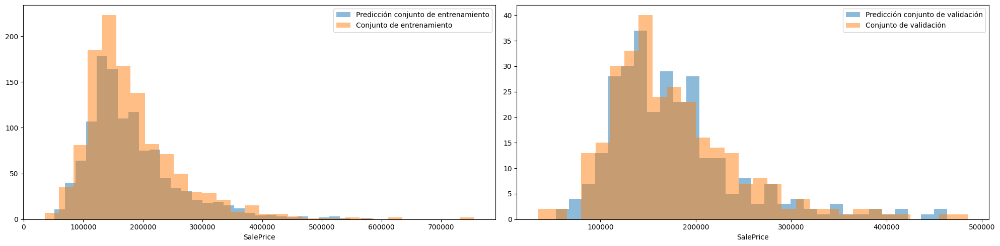

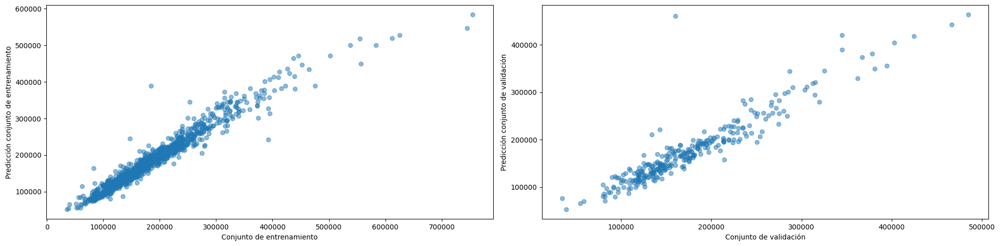

In [51]:
import matplotlib.pyplot as plt
import numpy as np

y_train_pred = np.expm1(best_model.predict(X_train))
y_train_ = np.expm1(y_train)
y_val_pred = np.expm1(best_model.predict(X_val))
y_val_ = np.expm1(y_val)

fig, axes = plt.subplots(1, 2, figsize=(20, 5))
axes = axes.flatten()
ax = axes[0]
ax.hist(y_train_pred, bins=30, alpha=0.5, label='Predicción conjunto de entrenamiento')
ax.hist(y_train_, bins=30, alpha=0.5, label='Conjunto de entrenamiento')
ax.set_xlabel('SalePrice')
ax.legend(loc='upper right')
ax = axes[1]
ax.hist(y_val_pred, bins=30, alpha=0.5, label='Predicción conjunto de validación')
ax.hist(y_val_, bins=30, alpha=0.5, label='Conjunto de validación')
ax.set_xlabel('SalePrice')
ax.legend(loc='upper right')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(20, 5))
axes = axes.flatten()
ax = axes[0]
ax.scatter(y_train_, y_train_pred, alpha = 0.5)
ax.set_xlabel('Conjunto de entrenamiento')
ax.set_ylabel('Predicción conjunto de entrenamiento')
ax = axes[1]
ax.scatter(y_val_, y_val_pred, alpha = 0.5)
ax.set_xlabel('Conjunto de validación')
ax.set_ylabel('Predicción conjunto de validación')
plt.tight_layout()
plt.show()

Ahora que encontramos los mejores parámetros y vimos que la diferencia entre el error de entrenamiento y validación es pequeña, es decir, no hay under u overfitting, reentrenamos utilizando todo el conjunto de datos de train (10000 datos).

In [52]:
X_train = data_cleaned.drop('SalePrice', axis=1)  
y_train = data_cleaned['SalePrice']
best_model = grid_search.fit(X_train, y_train)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001762 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3222
[LightGBM] [Info] Number of data points in the train set: 973, number of used features: 160
[LightGBM] [Info] Start training from score 12.017614
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000933 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3246
[LightGBM] [Info] Number of data points in the train set: 973, number of used features: 162
[LightGBM] [Info] Start training from score 12.025982
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of te

In [53]:
# Predecir enl conjuntos de entrenamiento
y_train_pred = model.predict(X_train)

# Calcular el error cuadrático medio el conjuntos de entrenamiento
mse_train = mean_squared_error(y_train, y_train_pred)

print("Error cuadrático medio del conjunto de entrenamiento:", mse_train)

Error cuadrático medio del conjunto de entrenamiento: 0.004838626096153079


## 10. Predicciones sobre nuevos datos

Una vez que estés conforme con los resultados del entrenamiento de tu modelo, haz una predicción del valor del precio de las casas sobre los datos de `test`.


Error cuadrático medio del conjunto de prueba: 0.1452009909168887


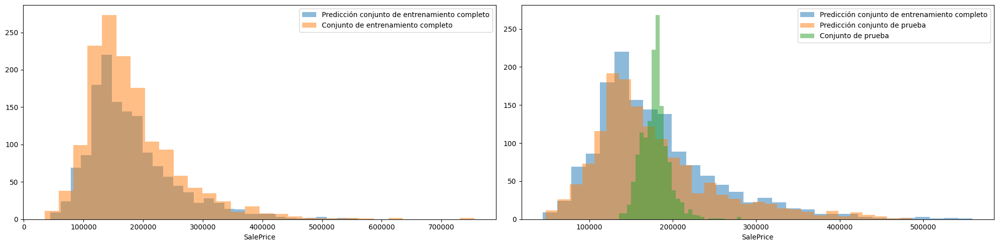

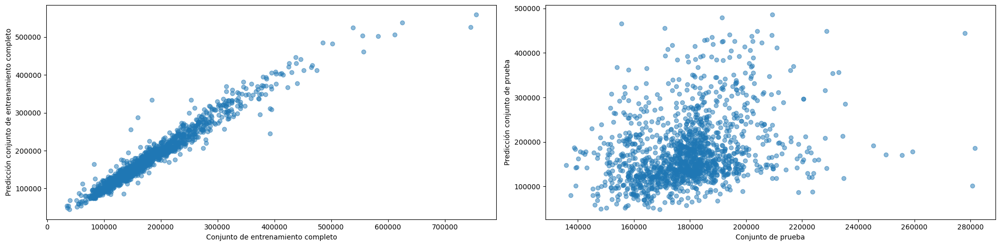

In [54]:
import matplotlib.pyplot as plt

y_train_pred = np.expm1(best_model.predict(X_train))
y_train_ = np.expm1(y_train)
y_test_pred =  np.expm1(best_model.predict(test_data))
sample_submission = pd.read_csv('dataset/sample_submission.csv')

mse_test = mean_squared_error( np.log1p(y_test_pred), np.log1p(sample_submission['SalePrice']))
print("\nError cuadrático medio del conjunto de prueba:", mse_test)

fig, axes = plt.subplots(1, 2, figsize=(20, 5))
axes = axes.flatten()
ax = axes[0]
ax.hist(y_train_pred, bins=30, alpha=0.5, label='Predicción conjunto de entrenamiento completo')
ax.hist(y_train_, bins=30, alpha=0.5, label='Conjunto de entrenamiento completo')
ax.set_xlabel('SalePrice')
ax.legend(loc='upper right')
ax = axes[1]
ax.hist(y_train_pred, bins=30,  alpha=0.5, label='Predicción conjunto de entrenamiento completo')
ax.hist(y_test_pred, bins=30, alpha=0.5, label='Predicción conjunto de prueba')
ax.hist(sample_submission['SalePrice'], bins=30, alpha=0.5, label='Conjunto de prueba')
ax.set_xlabel('SalePrice')
ax.legend(loc='upper right')
plt.tight_layout()
plt.show()

fig, axes = plt.subplots(1, 2, figsize=(20, 5))
axes = axes.flatten()
ax = axes[0]
ax.scatter(y_train_, y_train_pred, alpha = 0.5)
ax.set_xlabel('Conjunto de entrenamiento completo')
ax.set_ylabel('Predicción conjunto de entrenamiento completo')
ax = axes[1]
ax.scatter(sample_submission['SalePrice'], y_test_pred, alpha = 0.5)
ax.set_xlabel('Conjunto de prueba')
ax.set_ylabel('Predicción conjunto de prueba')
plt.tight_layout()
plt.show()

## Escribe tus conclusiones

- En primer lugar, se observa que el conjunto de prueba (test.csv y sample submission.csv) tiene una estadística diferente al conjunto de entrenamiento. Esto lo podemos ver en el histograma donde se ve que claramente, el conjunto de prueba consiste en casas con una media de precios más elevados y mucha menos variabilidad de precios, es decir, los precios estan mucho más cerca de la media. Además, el histograma del conjunto de entrenamiento no es simétrico respecto de la moda, tiene una cola más larga hacia precios altos. Mientras que el histograma del conjunto de prueba parece más simétrico respecto de la moda.

- La implementación de GridSearchCV resultó útil para disminuir el error de entrenamiento y la diferencia entre los errores de entrenamiento y validación.

- Podemos ver en los histogramas de los conjuntos de entrenamiento y validación, que el entrenamiento es bueno, y falla al predecir el conjunto de prueba por la razón que mencionamos antes, es decir que la estadística de las casas del conjunto de prueba es distinta.

- Se realizó un reentrenamiento de la red utilizando los 10000 datos del conjunto de entrenamiento, disminuyendo el error de entrenamiento en un 50%. Luego se utilizó este modelo para realizar las predicciones sobre el conjunto de prueba.

- Al ser modelo de árboles, no interesa demasiado realizar un feature engeniering debido a que a el modelo de árboles es robusto frente a variables que no tengan correlación, estén muy correlacionadas entre sí o tengan outliers.